In [60]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

In [61]:
df = pd.read_csv('Datasets/label.csv')
df

,Left_Shoulder_Angle,Right_Shoulder_Angle,Left_Elbow_Angle,Right_Elbow_Angle,Left_Wrist_Angle,Right_Wrist_Angle,Left_Hip_Angle,Right_Hip_Angle,Left_Knee_Angle,Right_Knee_Angle,Neck_Angle,Left_Ankle_Angle,Right_Ankle_Angle,Left_Heel_Angle,Right_Heel_Angle,Left_Foot_Index_Angle,Right_Foot_Index_Angle,Label
0,57.560364,8.905739,198.021898,210.802643,8.860333,10.509499,179.419460,187.092761,199.960568,196.612153,21.390257,199.148075,228.415769,62.046980,47.821461,345.410901,351.451797,1
1,58.804796,17.938139,240.444772,210.085147,53.923432,11.986242,174.497594,180.617447,204.319900,197.359277,353.600885,234.996271,230.088818,8.541182,42.411217,358.479579,351.599064,1
2,66.340221,16.929885,172.669875,209.001619,356.941629,12.917519,180.594488,182.194824,198.669814,202.165259,350.094691,223.538704,226.527556,15.398690,41.522153,356.612888,350.644648,1
3,62.771507,15.692037,179.324908,210.541627,359.722534,14.138074,180.384054,185.222696,198.466275,199.438819,341.668137,220.749473,229.690630,28.832056,35.758201,352.854062,351.330772,1
4,63.730818,15.318916,178.679337,213.506587,359.484738,15.763071,182.602836,185.197565,195.977440,199.155724,335.033822,219.384314,234.136778,32.564104,30.664314,351.383632,351.751616,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
933,280.680896,292.016860,164.577559,158.557485,352.036182,349.007952,205.564799,195.861149,8.090131,41.276471,5.332004,216.380596,185.418408,50.891105,109.581369,335.315142,344.179169,0
934,279.185951,291.211051,166.283222,159.335746,352.872827,349.473293,204.647761,195.212799,4.108663,31.429036,6.263176,218.133341,175.210468,56.098051,131.306809,335.188243,345.415740,0
935,278.461514,290.023536,166.921981,160.350314,353.189310,349.986958,204.557361,195.175844,1.920668,30.951483,5.788952,219.446842,181.288482,54.932039,120.592202,335.674160,343.823365,0
936,277.812178,289.035389,167.454265,160.703909,353.440398,350.182115,204.525862,195.123591,358.691762,32.363058,5.868439,221.156997,192.443359,55.087518,98.631934,336.547630,343.316911,0


In [62]:
# Print statistics of the median distances
df.describe()

,Left_Shoulder_Angle,Right_Shoulder_Angle,Left_Elbow_Angle,Right_Elbow_Angle,Left_Wrist_Angle,Right_Wrist_Angle,Left_Hip_Angle,Right_Hip_Angle,Left_Knee_Angle,Right_Knee_Angle,Neck_Angle,Left_Ankle_Angle,Right_Ankle_Angle,Left_Heel_Angle,Right_Heel_Angle,Left_Foot_Index_Angle,Right_Foot_Index_Angle,Label
count,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000,938.000000
mean,181.004818,216.869804,137.478988,153.434240,244.848954,228.096528,184.208216,185.035054,158.928475,160.744635,200.003382,178.603189,177.273774,169.341841,202.943034,188.548875,157.966487,0.733475
std,141.701530,145.430702,72.760034,78.951708,136.593405,145.453614,15.447099,10.255622,81.159417,61.220105,152.424763,39.039441,55.329309,138.926134,142.551648,163.630585,163.145269,0.442377
min,0.017885,0.213770,36.978868,12.510954,0.009951,0.025049,149.366439,156.747835,0.231747,0.279768,0.000830,97.558503,37.322586,1.608246,0.423352,1.004794,0.103415,0.000000
25%,42.116002,22.606758,64.172141,74.109330,123.807490,36.660014,173.627401,178.258584,152.051697,161.228455,33.864304,145.623608,126.056294,39.540794,35.101507,12.030177,10.073407,0.000000
50%,74.463732,303.539242,149.966803,166.870380,312.355207,315.459490,183.268569,183.318217,163.288443,173.517844,315.860269,190.989875,177.594601,60.648679,304.770614,324.031809,34.983199,1.000000
75%,331.565208,336.073032,180.321531,208.320099,343.230996,349.365275,196.181967,192.689727,210.930341,194.730849,327.187121,211.043767,217.403509,321.695889,332.447369,344.073446,347.547515,1.000000
max,359.739369,359.925037,351.705237,312.341843,359.963816,359.976453,306.311061,238.877983,359.992033,359.259081,359.993976,305.514529,349.835284,357.508328,359.767329,359.406317,359.898106,1.000000


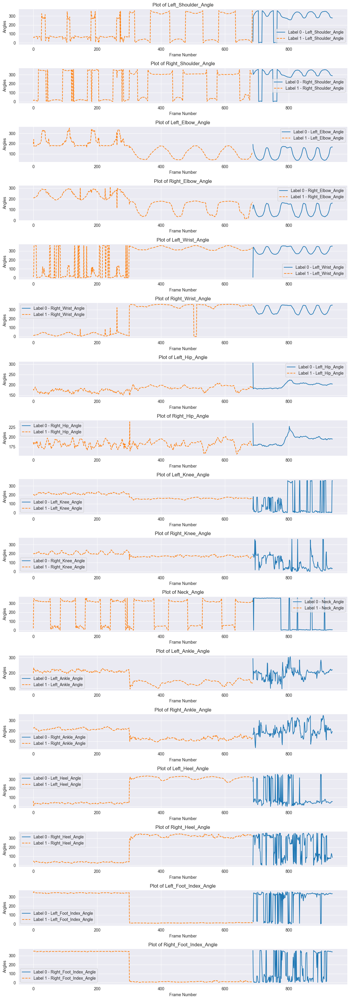

In [63]:
df
# Filter the dataset for label 0 and label 1
label_0_data = df[df['Label'] == 0]
label_1_data = df[df['Label'] == 1]

# Plot each angle in a separate subplot
num_angles = len(df.columns) - 1  # Exclude 'Label'
fig, axes = plt.subplots(nrows=num_angles, ncols=1, figsize=(12, 2 * num_angles))

for i, column in enumerate(df.columns):
    if column not in ['Label']:
        ax = axes[i] if num_angles > 1 else axes  # Select the appropriate subplot
        ax.plot(label_0_data.index, label_0_data[column], label=f'Label 0 - {column}')
        ax.plot(label_1_data.index, label_1_data[column], label=f'Label 1 - {column}', linestyle='--')
        ax.set_xlabel('Frame Number')
        ax.set_ylabel('Angles')
        ax.set_title(f'Plot of {column}')
        ax.legend()
        ax.grid(True)

plt.tight_layout()
plt.show()

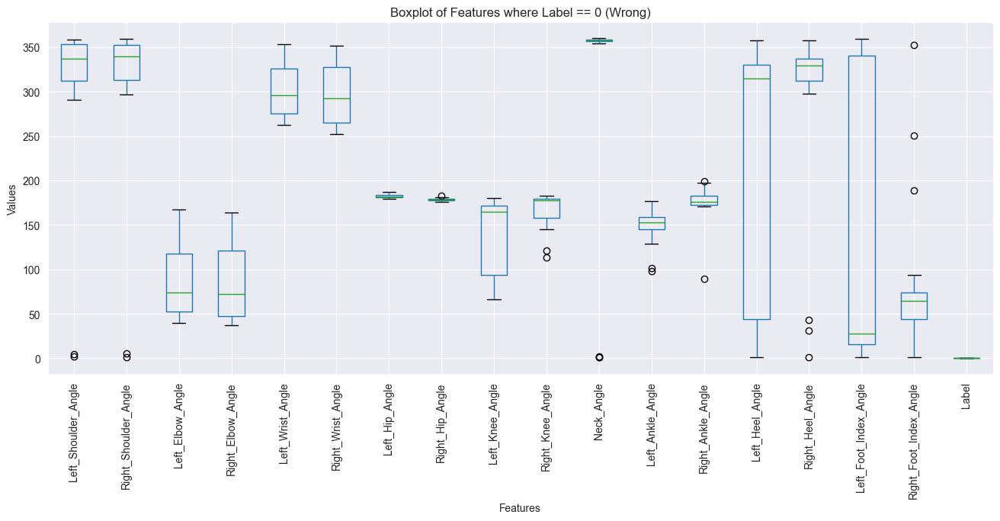

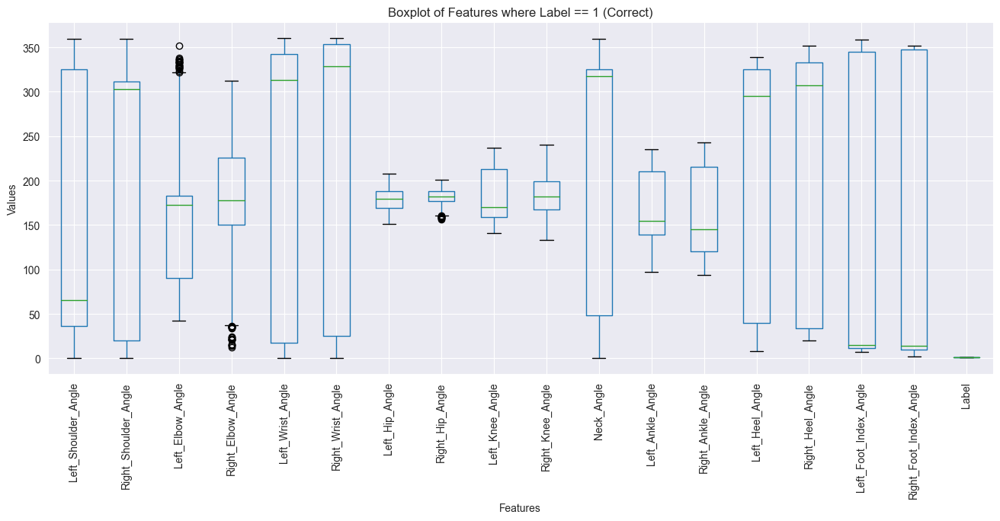

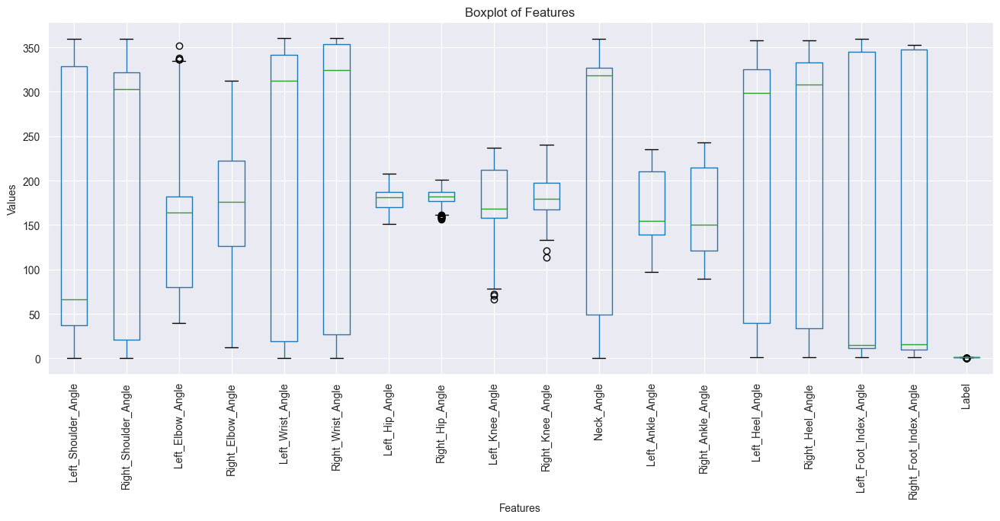

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 729 entries, 0 to 728
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Left_Shoulder_Angle     729 non-null    float64
 1   Right_Shoulder_Angle    729 non-null    float64
 2   Left_Elbow_Angle        729 non-null    float64
 3   Right_Elbow_Angle       729 non-null    float64
 4   Left_Wrist_Angle        729 non-null    float64
 5   Right_Wrist_Angle       729 non-null    float64
 6   Left_Hip_Angle          729 non-null    float64
 7   Right_Hip_Angle         729 non-null    float64
 8   Left_Knee_Angle         729 non-null    float64
 9   Right_Knee_Angle        729 non-null    float64
 10  Neck_Angle              729 non-null    float64
 11  Left_Ankle_Angle        729 non-null    float64
 12  Right_Ankle_Angle       729 non-null    float64
 13  Left_Heel_Angle         729 non-null    float64
 14  Right_Heel_Angle        729 non-null    fl

In [64]:
import pandas as pd
import numpy as np
from sklearn.metrics import pairwise_distances
import matplotlib.pyplot as plt

# Load your dataset
df = pd.read_csv('Datasets/label.csv')

# Calculate (Q1) and (Q3)
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)

# Calculate the IQR (interquartile range)
IQR = Q3 - Q1

# Define the lower and upper bounds for outlier detection
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = ((df < lower_bound) | (df > upper_bound)).any(axis=1)

# Remove outliers
df = df[~outliers]

# Compute pairwise distances between keypoints
distances = pairwise_distances(df)

# Compute the median distance for each keypoint
median_distances = np.median(distances, axis=1)

# Reset index
df.reset_index(drop=True, inplace=True)

# Plot boxplot
plt.figure(figsize=(16, 6))
df[df['Label'] == 0].boxplot()
plt.xticks(rotation=90)
plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of Features where Label == 0 (Wrong)')
plt.show()

plt.figure(figsize=(16, 6))
df[df['Label'] == 1].boxplot()
plt.xticks(rotation=90)
plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of Features where Label == 1 (Correct)')
plt.show()

plt.figure(figsize=(16, 6))
df.boxplot()
plt.xticks(rotation=90)
plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of Features')
plt.show()

# Display DataFrame information
df.info()

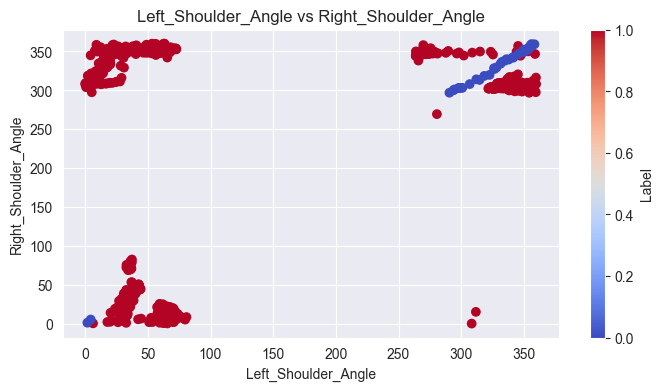

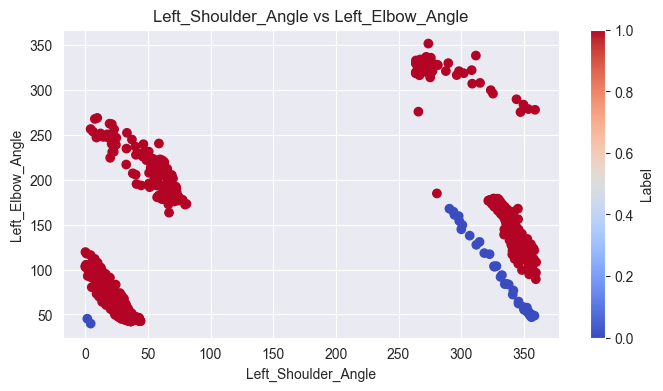

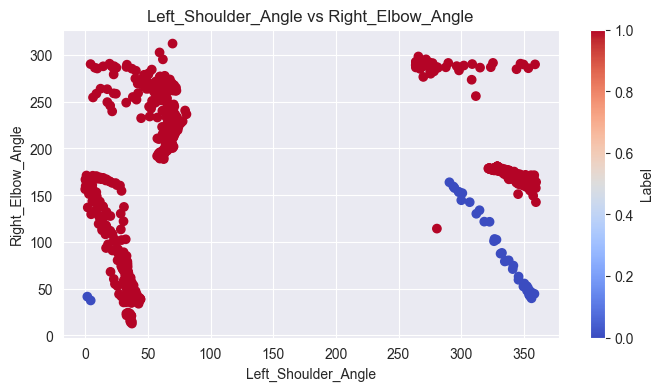

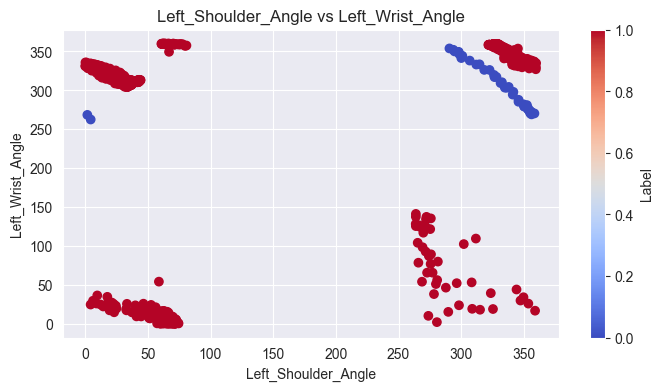

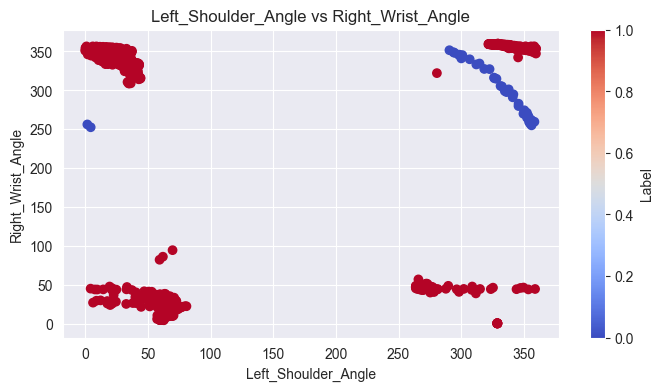

...

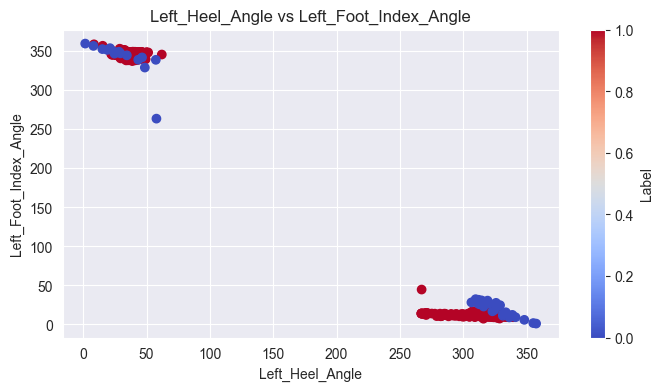

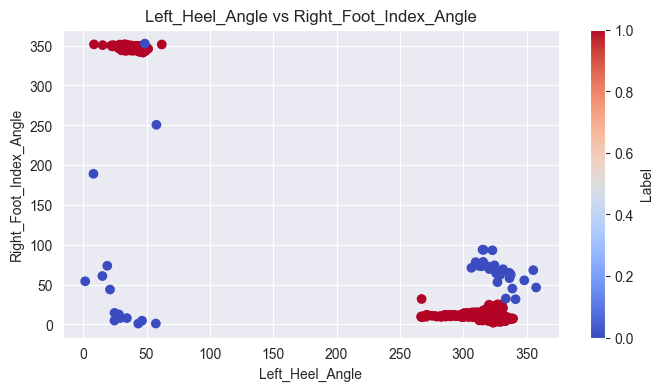

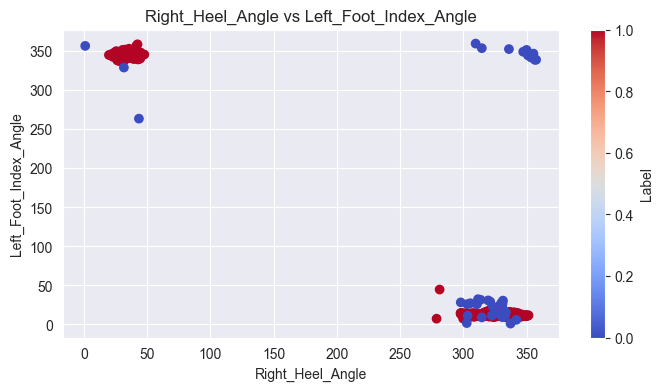

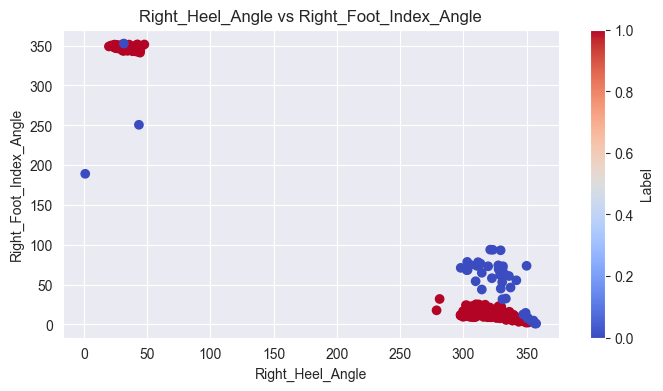

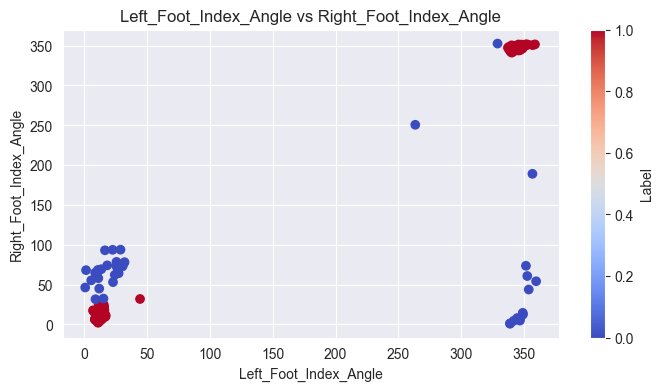

In [65]:
# Separate features and labels
features = df.drop(columns=['Label'])
labels = df['Label']


# Plot each column against each other column in different plots with colors based on labels
num_features = len(features.columns)

for i in range(num_features):
    for j in range(i+1, num_features):
        plt.figure(figsize=(8, 4))
        plt.scatter(features.iloc[:, i], features.iloc[:, j], c=labels, cmap='coolwarm')
        plt.xlabel(features.columns[i])
        plt.ylabel(features.columns[j])
        plt.title(f'{features.columns[i]} vs {features.columns[j]}')
        plt.colorbar(label='Label')
        plt.grid(True)
        plt.show()

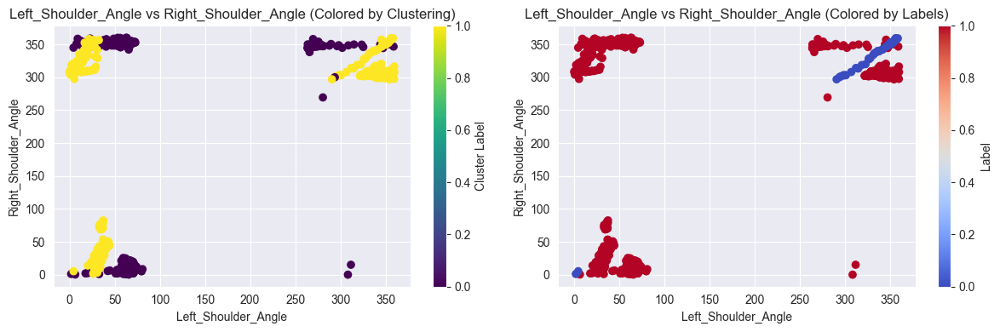

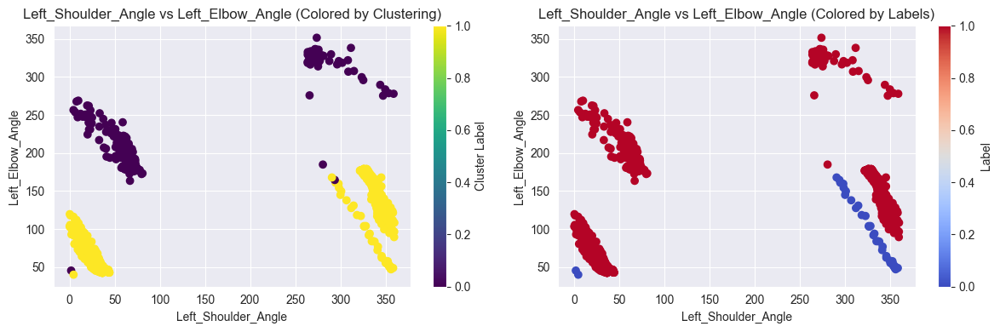

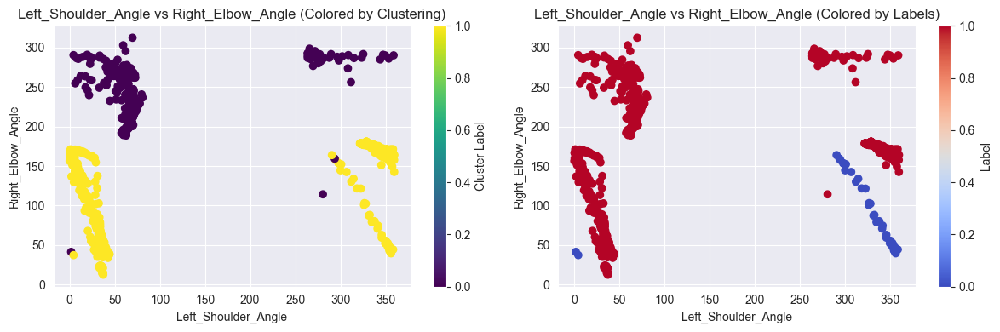

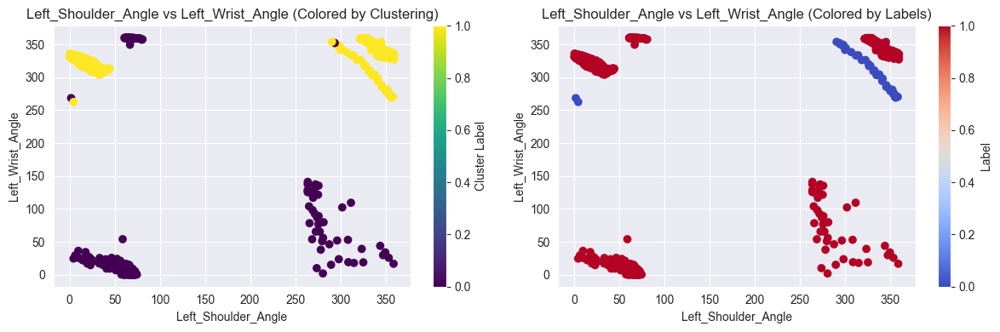

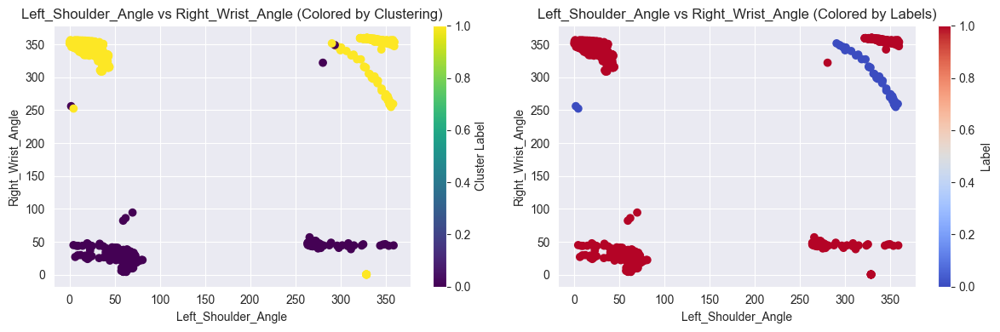

...

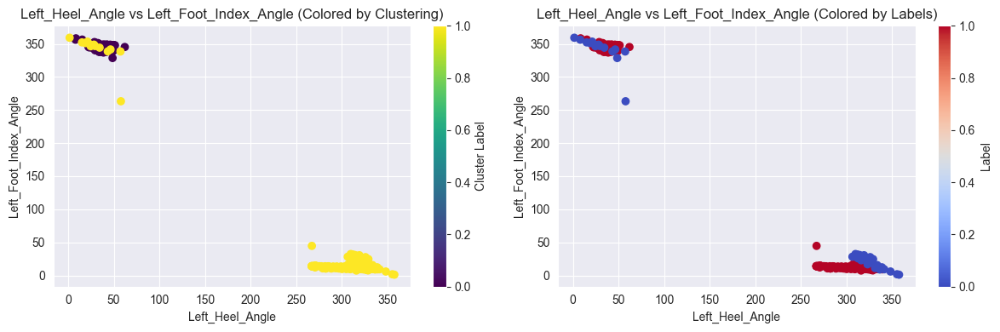

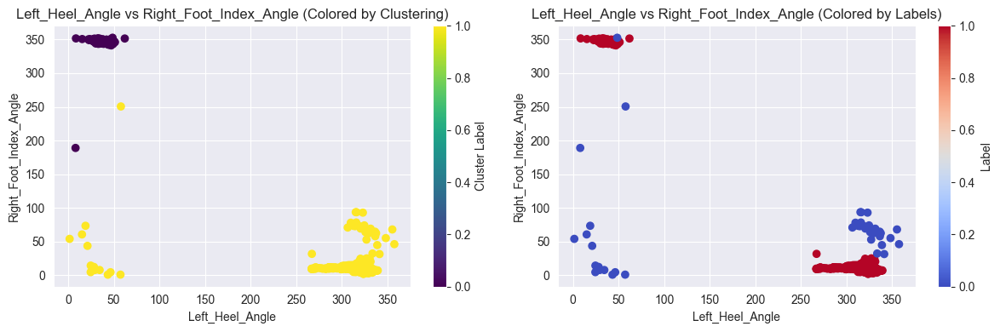

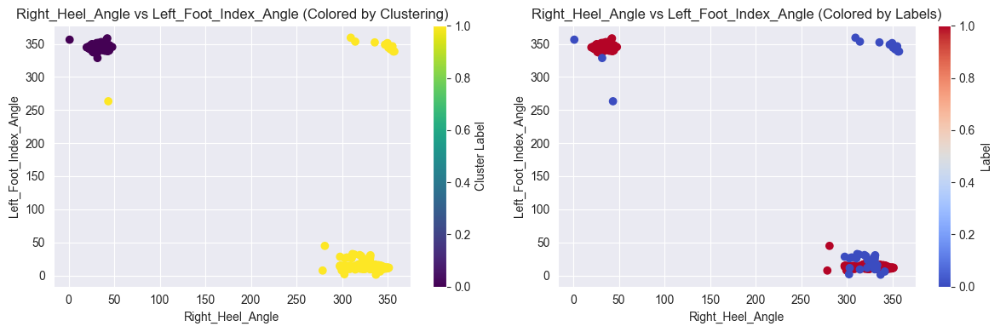

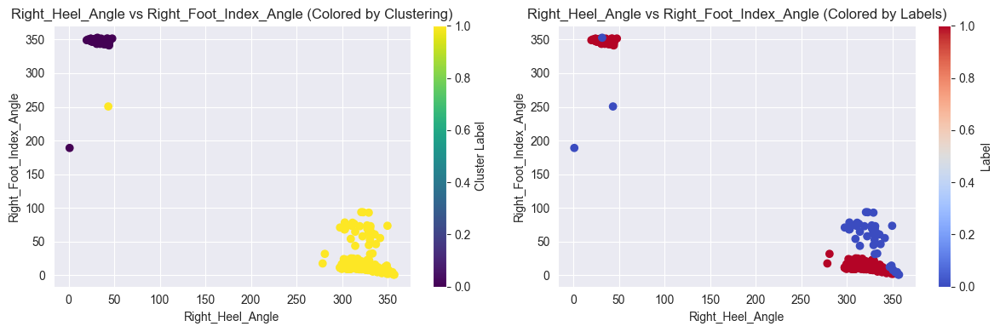

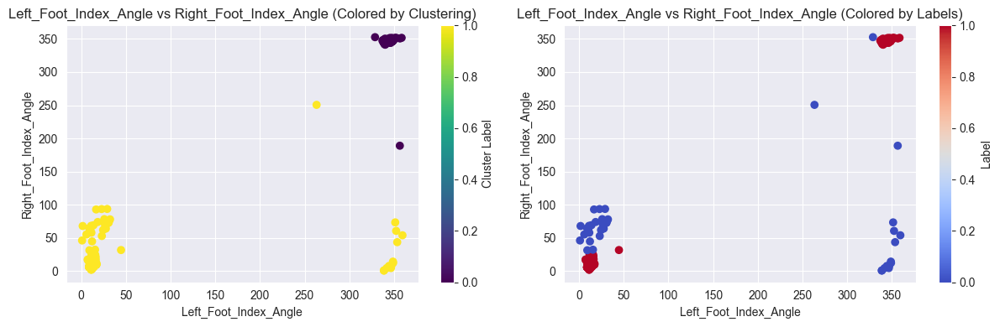

In [66]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load your dataset (replace 'label.csv' with your actual file path)
# df = pd.read_csv('label.csv')

# Separate features and labels
features = df.drop(columns=['Label'])
labels = df['Label']

# Perform KMeans clustering
kmeans = KMeans(n_clusters=2, random_state=42)
kmeans.fit(features)
cluster_labels = kmeans.labels_

# Plot each column against each other column in different plots with colors based on clustering
num_features = len(features.columns)

for i in range(num_features):
    for j in range(i+1, num_features):
        plt.figure(figsize=(12, 4))

        # Plot feature pair colored by clustering
        plt.subplot(1, 2, 1)
        plt.scatter(features.iloc[:, i], features.iloc[:, j], c=cluster_labels, cmap='viridis')
        plt.xlabel(features.columns[i])
        plt.ylabel(features.columns[j])
        plt.title(f'{features.columns[i]} vs {features.columns[j]} (Colored by Clustering)')
        plt.colorbar(label='Cluster Label')

        # Plot feature pair colored by labels
        plt.subplot(1, 2, 2)
        plt.scatter(features.iloc[:, i], features.iloc[:, j], c=labels, cmap='coolwarm')
        plt.xlabel(features.columns[i])
        plt.ylabel(features.columns[j])
        plt.title(f'{features.columns[i]} vs {features.columns[j]} (Colored by Labels)')
        plt.colorbar(label='Label')

        plt.tight_layout()
        plt.show()


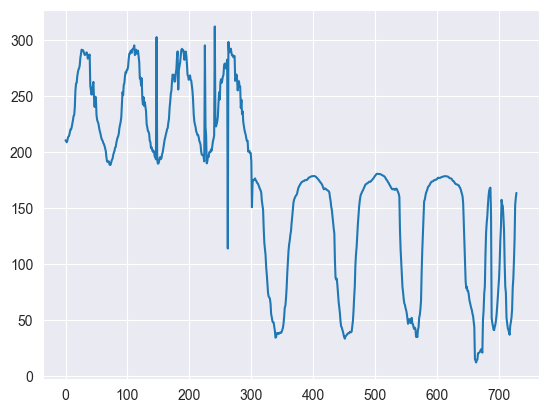

In [67]:
plt.plot(df['Right_Elbow_Angle'])
plt.show()